In [1]:
import jax
from jax.config import config
config.update("jax_enable_x64", True)

In [2]:
import scanpy as sc
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import moscot
from moscot.problems.time import TemporalProblem
import moscot.plotting as mpl
import pandas as pd
import os

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=200)

import mplscience

mplscience.available_styles()
mplscience.set_style(reset_current=True)
plt.rcParams['legend.scatterpoints'] = 1 

['default', 'despine']


In [33]:
adata = sc.read("/lustre/groups/ml01/workspace/moscot_paper/pancreas/pancreas_multiome_2022_processed.h5ad")

In [34]:
adata.shape

(16918, 242922)

In [3]:
output_dir = "."

In [4]:
tp0 = TemporalProblem.load("/lustre/groups/ml01/workspace/moscot_paper/pancreas/TemporalProblem.pkl")

In [5]:
order_celltypes = ['Ngn3 low', 'Ngn3 high cycling', 'Ngn3 high', 'Eps. progenitors', 'Fev+', 'Fev+ Alpha', 
                   'Fev+ Beta', 'Fev+ Delta', 'Alpha', 'Beta', 'Delta', 'Epsilon']

In [6]:
color_dict = { 'Prlf. Ductal': '#f7b6d2', 'Ductal': '#d62728', 'Imm. Acinar': '#ffbb78', 'Mat. Acinar': '#98df8a',
    'Alpha': '#1f77b4', 'Beta': '#ff7f0e', 'Delta': '#279e68', 'Eps. progenitors': '#aa40fc', 'Epsilon': '#8c564b',
       'Fev+': '#e377c2', 'Fev+ Alpha': '#b5bd61', 'Fev+ Beta': '#aec7e8', 'Fev+ Delta': '#aec7e8', 'Fev+ Delta,0': '#ffbb78', 'Fev+ Delta,1':'#98df8a',
        'Fev+ Delta,2': '#17becf', 'Ngn3 high cycling': '#aec7e8',
        'Ngn3 high,0': '#ff9896', 'Ngn3 high,1':'#f0b98d', 'Ngn3 low': '#c5b0d5'
}

In [7]:
tp0.adata.obs["refinement"] = tp0.adata.obs["refinement"].astype("category")
tp0.adata.uns["refinement_colors"] = [color_dict[ct] for ct in tp0.adata.obs["refinement"].cat.categories]

In [8]:
chromvar_features = [col for col in tp0.adata.obs.columns if col.startswith("ENS")]

In [9]:
tp0.pull(14.5, 15.5, data="celltype", subset="Delta", key_added="Delta_pull")

In [10]:
delta_drivers = tp0.compute_feature_correlation(obs_key="Delta_pull", features=chromvar_features)

In [52]:
tp0.adata.shape, adata.shape

((9365, 127816), (16918, 242922))

In [39]:
sc.pp.normalize_total(adata)

In [40]:
sc.pp.log1p(adata)

In [44]:
(adata.var["modality"] =="GEX").sum()

14663

In [35]:
[el for el in adata.var_names if el.startswith("Fox")]

['Foxa2',
 'Foxo4',
 'Foxo1',
 'Foxd3',
 'Foxj3',
 'Foxo6',
 'Foxk1',
 'Foxp2',
 'Foxp1',
 'Foxj2',
 'Foxm1',
 'Foxa3',
 'Foxo3',
 'Foxred1',
 'Foxj1',
 'Foxk2',
 'Foxc1',
 'Foxn3',
 'Foxred2',
 'Foxp4',
 'Foxn2']

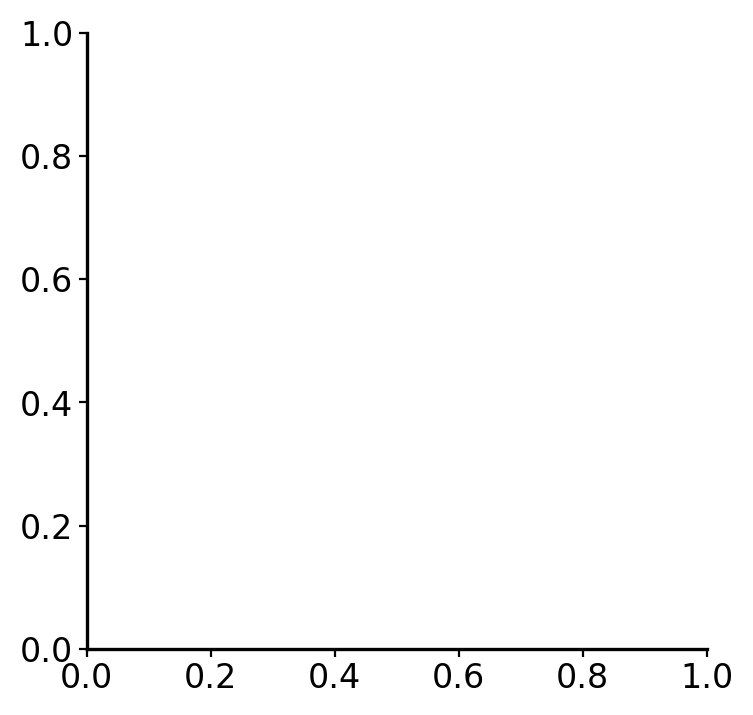

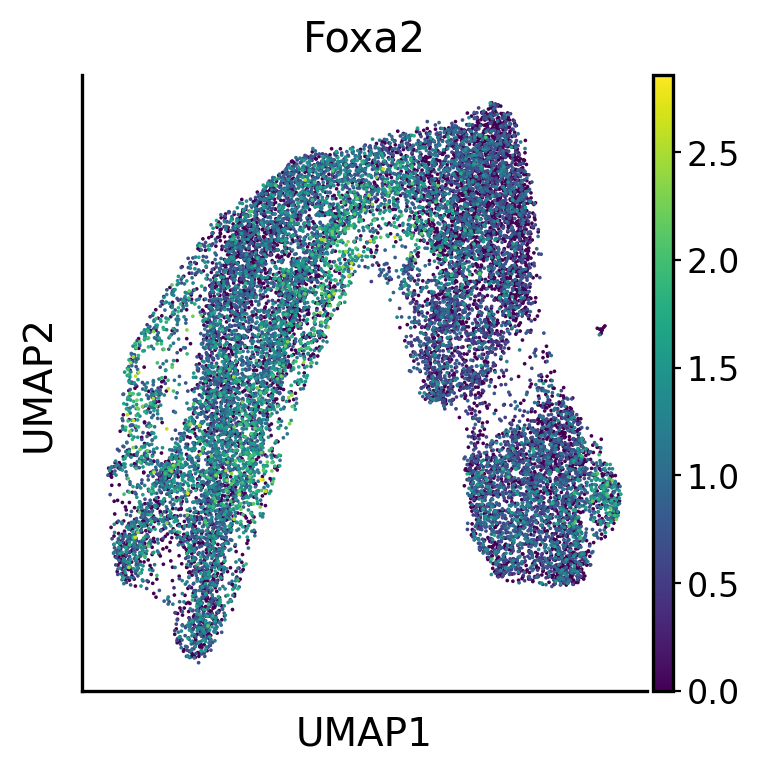

In [54]:
sc.pl.umap(adata, color="Foxa2")

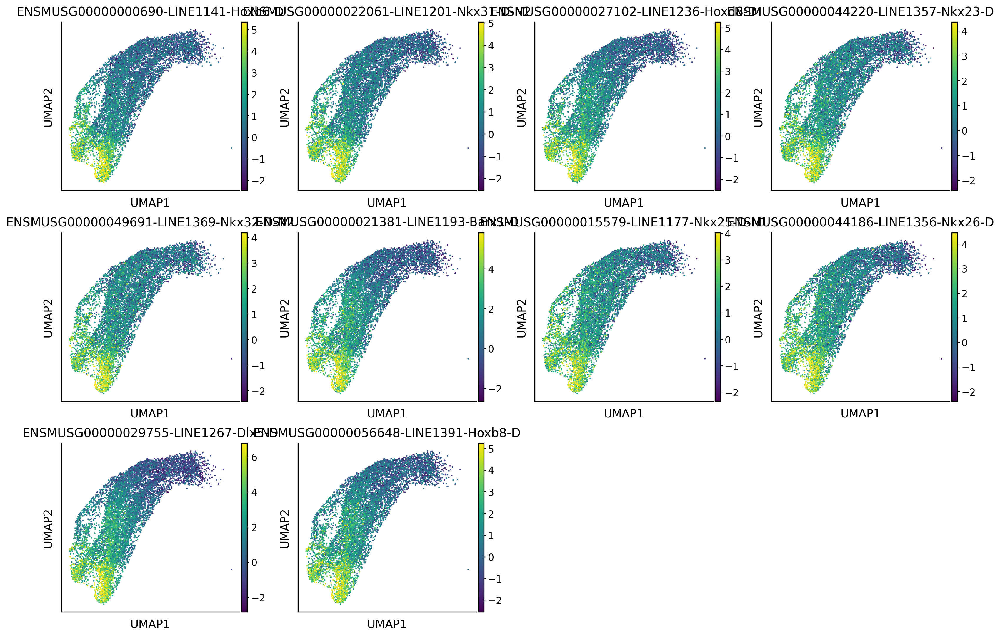

In [12]:
sc.pl.umap(tp0.adata, color=delta_drivers.index[:10], vmin="p01", vmax="p99")

In [13]:
tp0.pull(14.5, 15.5, data="celltype", subset="Beta", key_added="Beta_pull")

In [44]:
beta_drivers = tp0.compute_feature_correlation(obs_key="Beta_pull", features=chromvar_features, annotation={"celltype": ["Beta", "Alpha", "Fev+ Beta"]})

In [45]:
beta_drivers

,Beta_pull_corr,Beta_pull_pval,Beta_pull_qval,Beta_pull_ci_low,Beta_pull_ci_high
ENSMUSG00000075588-LINE1434-Hoxb2-I,0.390611,1.783465e-71,1.401803e-68,0.351622,0.428247
ENSMUSG00000029644-LINE1257-Pdx1-D-N2,0.360698,3.266523e-60,1.283743e-57,0.320730,0.399383
ENSMUSG00000055435-LINE664-Maf-I-N4,0.358694,1.673074e-59,2.630072e-57,0.318664,0.397447
ENSMUSG00000047591-LINE639-Mafa-I-N4,0.358694,1.673074e-59,2.630072e-57,0.318664,0.397447
ENSMUSG00000040632-LINE223-Nrl-I,0.358694,1.673074e-59,2.630072e-57,0.318664,0.397447
...,...,...,...,...,...
ENSMUSG00000050295-LINE1086-Foxc1-D-N2,-0.255253,1.148182e-29,8.356213e-29,-0.297023,-0.212508
ENSMUSG00000046714-LINE1082-Foxc2-D,-0.257077,4.362747e-30,3.297230e-29,-0.298802,-0.214371
ENSMUSG00000074676-LINE1105-Foxs1-I,-0.257077,4.362747e-30,3.297230e-29,-0.298802,-0.214371
ENSMUSG00000056829-LINE1099-Foxb2-I,-0.287320,1.405794e-37,1.811400e-36,-0.328254,-0.245309


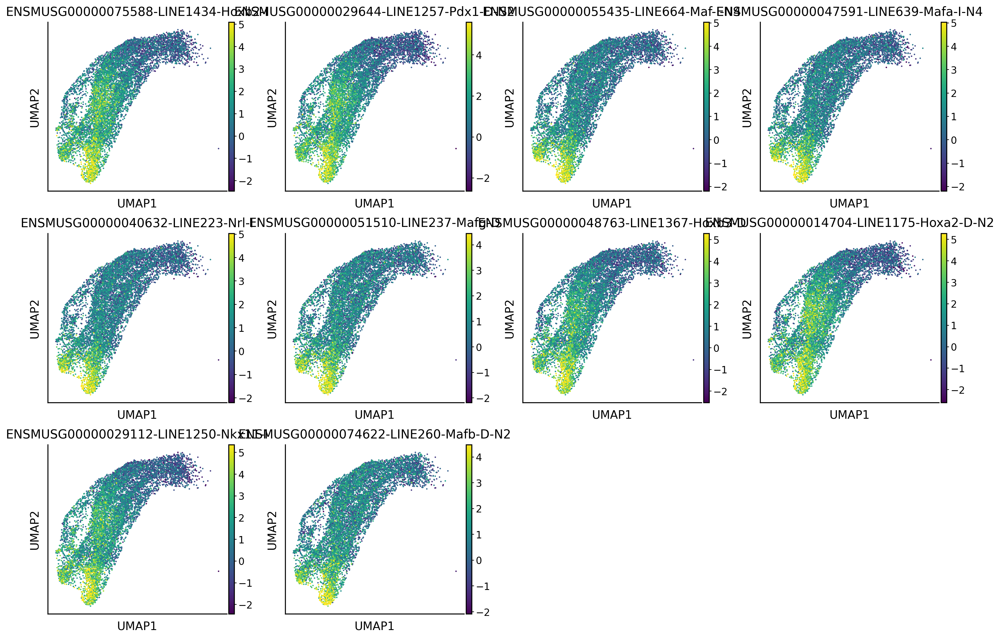

In [46]:
sc.pl.umap(tp0.adata, color=beta_drivers.index[:10], vmin="p01", vmax="p99")

In [24]:
tp0.pull(14.5, 15.5, data="celltype", subset="Alpha", key_added="Alpha_pull")

In [25]:
alpha_drivers = tp0.compute_feature_correlation(obs_key="Alpha_pull", features=chromvar_features)

In [27]:
alpha_drivers.index[:20]

Index(['ENSMUSG00000035451-LINE1065-Foxa1-I',
       'ENSMUSG00000056829-LINE1099-Foxb2-I',
       'ENSMUSG00000059246-LINE1100-Foxb1-D',
       'ENSMUSG00000030067-LINE1050-Foxp1-D',
       'ENSMUSG00000040891-LINE3490-Foxa3-I-N47',
       'ENSMUSG00000050295-LINE1086-Foxc1-D-N2',
       'ENSMUSG00000078302-LINE1106-Foxd1-D',
       'ENSMUSG00000074676-LINE1105-Foxs1-I',
       'ENSMUSG00000046714-LINE1082-Foxc2-D',
       'ENSMUSG00000051490-LINE4226-Foxd4-I-N53',
       'ENSMUSG00000055210-LINE1092-Foxd2-I',
       'ENSMUSG00000044518-LINE1081-Foxe3-I',
       'ENSMUSG00000000690-LINE1141-Hoxb6-D',
       'ENSMUSG00000022061-LINE1201-Nkx31-D-N2',
       'ENSMUSG00000045515-LINE1360-Pou3f3-D',
       'ENSMUSG00000037025-LINE1066-Foxa2-D-N1',
       'ENSMUSG00000001497-LINE1643-Pax9-I',
       'ENSMUSG00000020950-LINE1044-Foxg1-D-N2',
       'ENSMUSG00000034998-LINE2806-Foxn2-I-N8',
       'ENSMUSG00000032998-LINE1051-Foxj3-D-N3'],
      dtype='object')

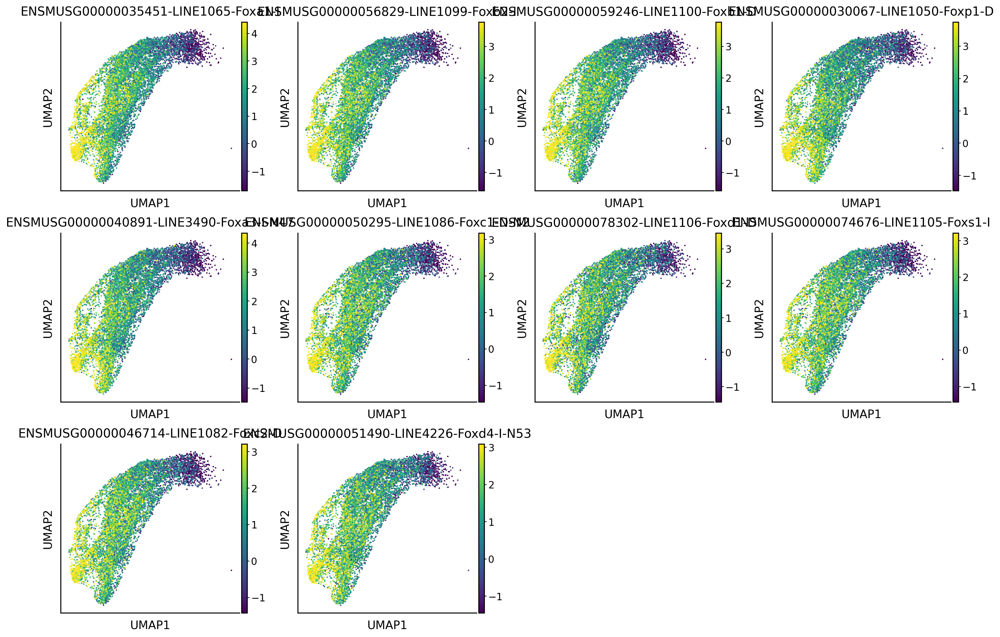

In [22]:
sc.pl.umap(tp0.adata, color=alpha_drivers.index[:10], vmin="p05", vmax="p95")

In [23]:
tp0.pull(14.5, 15.5, data="celltype", subset="Epsilon", key_added="Epsilon_pull")

In [24]:
eps_drivers = tp0.compute_feature_correlation(obs_key="Epsilon_pull", features=chromvar_features)

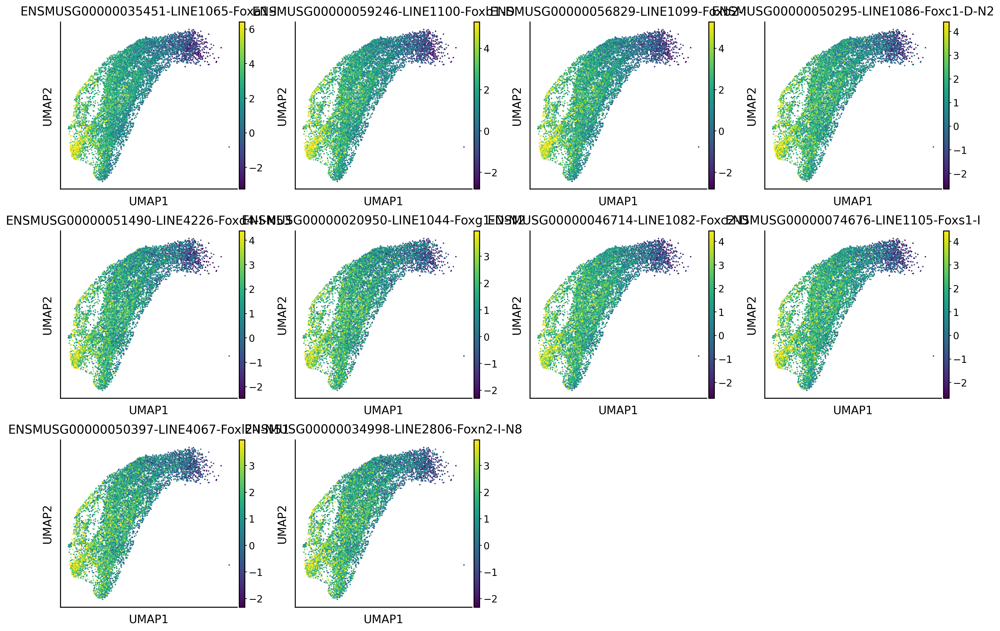

In [25]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:10], vmin="p01", vmax="p99")

In [36]:
eps_drivers = tp0.compute_feature_correlation(obs_key="Epsilon_pull", features=chromvar_features, annotation={"celltype": ["Epsilon", "Alpha", "Delta", "Ngn3 high", "Fev+ Delta"]})

In [37]:
eps_drivers

,Epsilon_pull_corr,Epsilon_pull_pval,Epsilon_pull_qval,Epsilon_pull_ci_low,Epsilon_pull_ci_high
ENSMUSG00000059246-LINE1100-Foxb1-D,0.184220,1.501974e-38,5.902759e-36,0.156912,0.211247
ENSMUSG00000056829-LINE1099-Foxb2-I,0.184220,1.501974e-38,5.902759e-36,0.156912,0.211247
ENSMUSG00000000690-LINE1141-Hoxb6-D,0.182621,6.727275e-38,1.762546e-35,0.155297,0.209666
ENSMUSG00000030067-LINE1050-Foxp1-D,0.179522,1.181225e-36,2.321108e-34,0.152169,0.206600
ENSMUSG00000020950-LINE1044-Foxg1-D-N2,0.177589,6.870567e-36,9.000443e-34,0.150217,0.204688
...,...,...,...,...,...
ENSMUSG00000068302-LINE1413-Noto-D,-0.143971,5.425589e-24,1.254268e-22,-0.171399,-0.116320
ENSMUSG00000020453-LINE325-Patz1-I,-0.147261,4.843493e-25,1.228060e-23,-0.174659,-0.119635
ENSMUSG00000026459-LINE85-Myog-D,-0.147883,3.048354e-25,8.262090e-24,-0.175276,-0.120262
ENSMUSG00000000942-LINE1144-Hoxa4-D,-0.160554,1.562154e-29,6.462384e-28,-0.187827,-0.133033


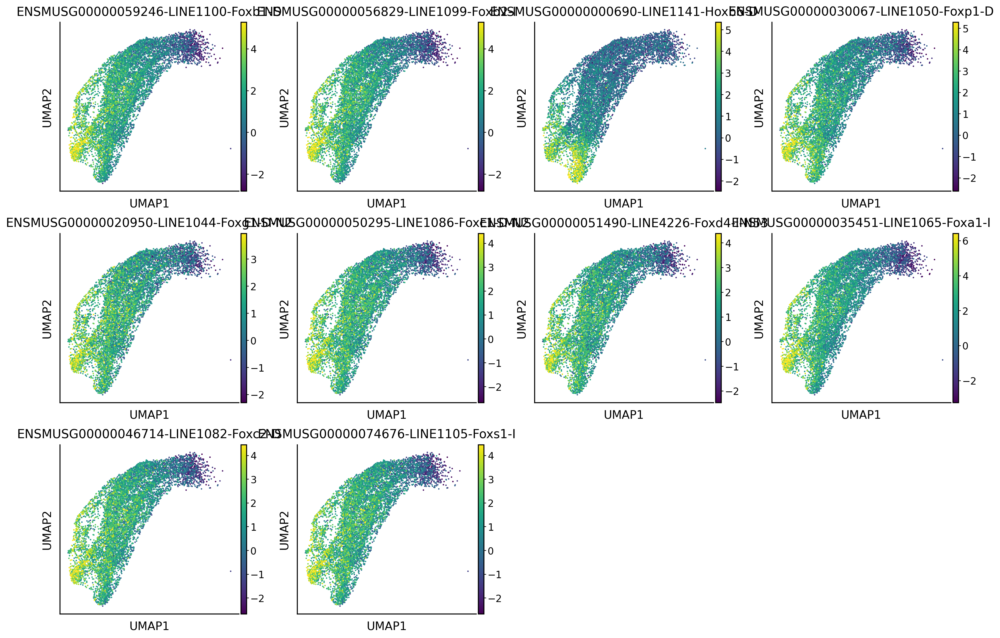

In [38]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:10], vmin="p01", vmax="p99")

In [39]:
tp0.pull(14.5, 15.5, data="celltype", subset=["Epsilon", "Delta", "Fev+ Delta", "Eps. progenitors"], key_added="eps-delta")

In [40]:
eps_drivers = tp0.compute_feature_correlation(obs_key="eps-delta", features=chromvar_features, annotation={"celltype": ["Ngn3 high", "Eps. progenitors"]})

In [41]:
eps_drivers

,eps-delta_corr,eps-delta_pval,eps-delta_qval,eps-delta_ci_low,eps-delta_ci_high
ENSMUSG00000035451-LINE1065-Foxa1-I,0.224707,1.648840e-48,1.295988e-45,0.195447,0.253567
ENSMUSG00000059246-LINE1100-Foxb1-D,0.205925,8.430987e-41,2.208918e-38,0.176434,0.235048
ENSMUSG00000056829-LINE1099-Foxb2-I,0.205925,8.430987e-41,2.208918e-38,0.176434,0.235048
ENSMUSG00000040891-LINE3490-Foxa3-I-N47,0.197257,1.708544e-37,3.357290e-35,0.167665,0.226493
ENSMUSG00000030067-LINE1050-Foxp1-D,0.186092,1.831366e-33,2.878907e-31,0.156379,0.215469
...,...,...,...,...,...
ENSMUSG00000020656-LINE1130-Grhl1-I,-0.102089,5.418801e-11,1.092097e-09,-0.132280,-0.071710
ENSMUSG00000004040-LINE1781-Stat3-D,-0.102648,4.249726e-11,8.790224e-10,-0.132834,-0.072271
ENSMUSG00000021255-LINE1599-Esrrb-D-N3,-0.103104,3.482137e-11,7.397189e-10,-0.133287,-0.072729
ENSMUSG00000063659-LINE743-Zfp238-I,-0.103734,2.639221e-11,5.762300e-10,-0.133913,-0.073364


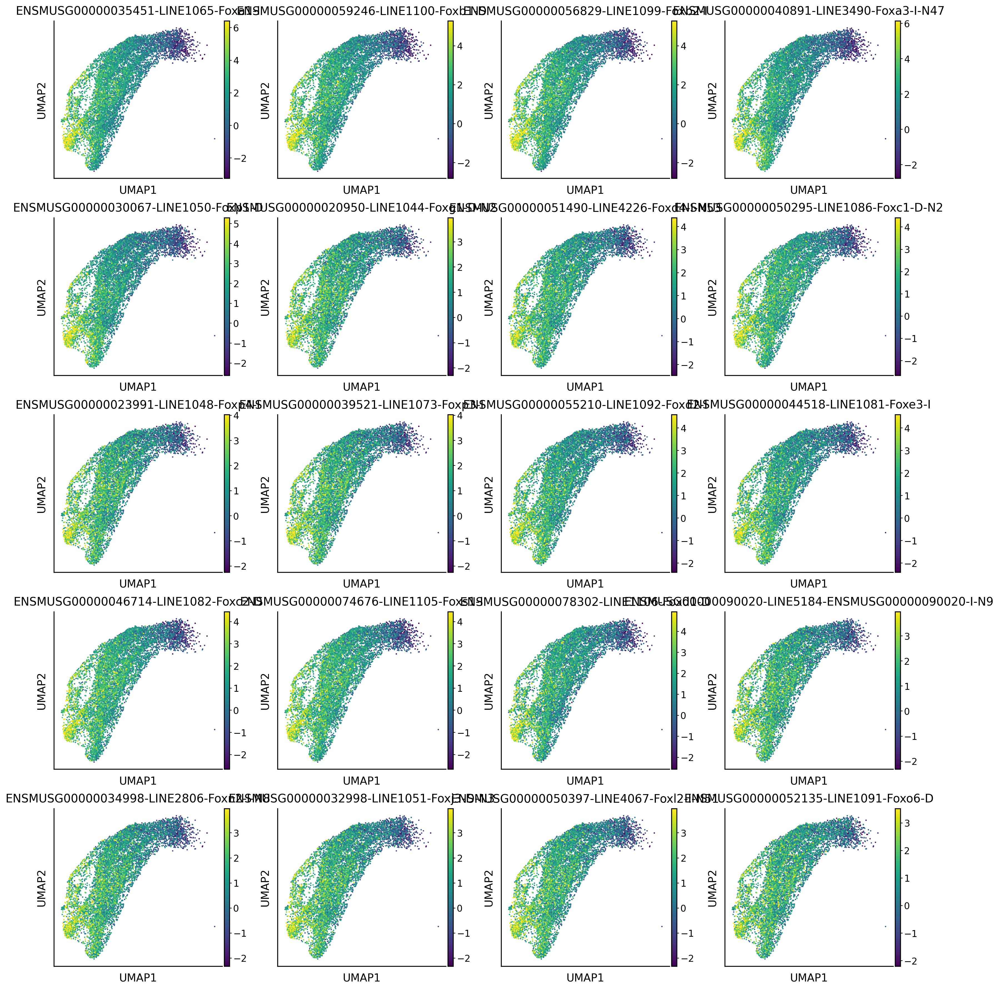

In [42]:
sc.pl.umap(tp0.adata, color=eps_drivers.index[:20], vmin="p01", vmax="p99")